# Brazilian eCommerce Dataset - KMeans Customer Segmentation

## Olist's Business Model

**[Olist](http://www.olist.com/)** is a **Brazilian** departmental store (*marketplace*) that **operates in e-commerce segment, but is not an e-commerce itself** (*as she says*). It operates as a SaaS (*Software as a Service*) technology company since 2015. It offers a marketplace solution (*of e-commerce segment*) to shopkeepers of all sizes (*and for most segments*) to increase their sales whether they have online presence or not. 

## Olist's Solution

Olist's solution consists of three aspects: Software, Contracts with the main marketplaces and Reputation sharing. The diagram below shows how Olist links marketplaces, consumers (*Portuguese: consumidores*), and retailers (*Portuguese: varejistas*)

![Olist’s marketplace model](https://olist.com/wp-content/uploads/2018/04/Group-40.svg)

## What Olist says?

Olist says she... 

1. ... is a large department store within marketplaces.
2. ... is connected to the main e-commerces of Brazil.
3. ... does not buy products. 
4. ... does not keep products in stock.
5. ... does not carry out shipping of any products offered in its store. 
6. All products are sold and shipped by the thousands of shopkeepers (**registered on Olist***) who sell through Olist.
7. Her strength lies in union of all participating shopkeepers, who are selling physical products. 
8. Participant shopkeeper is responsible for separating, packing, and taking products to the logistics operator.



## Data Model

On Kaggle, she shared its data of 100k orders from 2016 to 2018. There are 8+1 datasets to play with and explore. The data model has been described in image below and it is organised and normalised for each category.

![Data Model](https://i.imgur.com/HRhd2Y0.png) 

## Import libraries

#### Base Libraries

In [1]:
import sys 

import os 
import random

import numpy as np 
import pandas as pd 

from scipy import stats

import matplotlib.pyplot as plt
import seaborn as sns

pd.options.display.max_rows = 999

plt.style.use('ggplot')

#### scikit-learn Libraries

In [2]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans

## Importing Data

#### File Directory

In [3]:
file_dir = '/Users/juan/Desktop/eCommerce/data/'

El modelo de datos está compuesto por 8 Datasets, de los cuáles nos interesa trabajar con 6 (no utilizaremos la visión de los comercios). 

En concreto, para realizar la segmentación de clientes usaremos *Customers*, *Orders* y *Payments*

#### Customers Dataset

In [4]:
customers_ = pd.read_csv(file_dir + 'olist_customers_dataset.csv')

In [5]:
customers_.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Columns: 5 entries, customer_id to customer_state
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [6]:
customers_.head(3).T

,0,1,2
customer_id,06b8999e2fba1a1fbc88172c00ba8bc7,18955e83d337fd6b2def6b18a428ac77,4e7b3e00288586ebd08712fdd0374a03
customer_unique_id,861eff4711a542e4b93843c6dd7febb0,290c77bc529b7ac935b93aa66c333dc3,060e732b5b29e8181a18229c7b0b2b5e
customer_zip_code_prefix,14409,9790,1151
customer_city,franca,sao bernardo do campo,sao paulo
customer_state,SP,SP,SP


#### Orders Dataset

In [7]:
orders_ = pd.read_csv(file_dir + 'olist_orders_dataset.csv')

In [8]:
orders_.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Columns: 8 entries, order_id to order_estimated_delivery_date
dtypes: object(8)
memory usage: 6.1+ MB


In [9]:
orders_.head(3).T

,0,1,2
order_id,e481f51cbdc54678b7cc49136f2d6af7,53cdb2fc8bc7dce0b6741e2150273451,47770eb9100c2d0c44946d9cf07ec65d
customer_id,9ef432eb6251297304e76186b10a928d,b0830fb4747a6c6d20dea0b8c802d7ef,41ce2a54c0b03bf3443c3d931a367089
order_status,delivered,delivered,delivered
order_purchase_timestamp,2017-10-02 10:56:33,2018-07-24 20:41:37,2018-08-08 08:38:49
order_approved_at,2017-10-02 11:07:15,2018-07-26 03:24:27,2018-08-08 08:55:23
order_delivered_carrier_date,2017-10-04 19:55:00,2018-07-26 14:31:00,2018-08-08 13:50:00
order_delivered_customer_date,2017-10-10 21:25:13,2018-08-07 15:27:45,2018-08-17 18:06:29
order_estimated_delivery_date,2017-10-18 00:00:00,2018-08-13 00:00:00,2018-09-04 00:00:00


#### Order Payments Dataset

In [10]:
order_payments_ = pd.read_csv(file_dir + 'olist_order_payments_dataset.csv')

In [11]:
order_payments_.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Columns: 5 entries, order_id to payment_value
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


In [12]:
order_payments_.head(3).T

,0,1,2
order_id,b81ef226f3fe1789b1e8b2acac839d17,a9810da82917af2d9aefd1278f1dcfa0,25e8ea4e93396b6fa0d3dd708e76c1bd
payment_sequential,1,1,1
payment_type,credit_card,credit_card,credit_card
payment_installments,8,1,1
payment_value,99.33,24.39,65.71


#### Order Items Dataset

In [13]:
order_items_ = pd.read_csv(file_dir + 'olist_order_items_dataset.csv')

In [14]:
order_items_.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Columns: 7 entries, order_id to freight_value
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


In [15]:
order_items_.head(3).T

,0,1,2
order_id,00010242fe8c5a6d1ba2dd792cb16214,00018f77f2f0320c557190d7a144bdd3,000229ec398224ef6ca0657da4fc703e
order_item_id,1,1,1
product_id,4244733e06e7ecb4970a6e2683c13e61,e5f2d52b802189ee658865ca93d83a8f,c777355d18b72b67abbeef9df44fd0fd
seller_id,48436dade18ac8b2bce089ec2a041202,dd7ddc04e1b6c2c614352b383efe2d36,5b51032eddd242adc84c38acab88f23d
shipping_limit_date,2017-09-19 09:45:35,2017-05-03 11:05:13,2018-01-18 14:48:30
price,58.9,239.9,199
freight_value,13.29,19.93,17.87


#### Products Dataset 

In [16]:
products_ = pd.read_csv(file_dir + 'olist_products_dataset.csv')

In [17]:
products_.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Columns: 9 entries, product_id to product_width_cm
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


In [18]:
products_.head(3).T

,0,1,2
product_id,1e9e8ef04dbcff4541ed26657ea517e5,3aa071139cb16b67ca9e5dea641aaa2f,96bd76ec8810374ed1b65e291975717f
product_category_name,perfumaria,artes,esporte_lazer
product_name_lenght,40,44,46
product_description_lenght,287,276,250
product_photos_qty,1,1,1
product_weight_g,225,1000,154
product_length_cm,16,30,18
product_height_cm,10,18,9
product_width_cm,14,20,15


#### Reviews Dataset

In [19]:
reviews_ = pd.read_csv(file_dir + 'olist_order_reviews_dataset.csv')

In [20]:
reviews_.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Columns: 7 entries, review_id to review_answer_timestamp
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


In [21]:
reviews_.head(3).T

,0,1,2
review_id,7bc2406110b926393aa56f80a40eba40,80e641a11e56f04c1ad469d5645fdfde,228ce5500dc1d8e020d8d1322874b6f0
order_id,73fc7af87114b39712e6da79b0a377eb,a548910a1c6147796b98fdf73dbeba33,f9e4b658b201a9f2ecdecbb34bed034b
review_score,4,5,5
review_comment_title,NaN,NaN,NaN
review_comment_message,NaN,NaN,NaN
review_creation_date,2018-01-18 00:00:00,2018-03-10 00:00:00,2018-02-17 00:00:00
review_answer_timestamp,2018-01-18 21:46:59,2018-03-11 03:05:13,2018-02-18 14:36:24


## Complete Customer DataFrame Generation (including EDA)

Una vez cargados todos los Datasets, vamos a construir un único DataFrame de trabajo que contenta todos los datos. 

Para ello, **es importante validar la estructura de los Joins y el número de registros en cada una de las tablas**.

In [22]:
datasets = {
    'Customers': customers_,
    'Orders': orders_,
    'Payments': order_payments_,
}

for x, y in datasets.items():
    print(f'{x}', (list(y.shape)))

Customers [99441, 5]
Orders [99441, 8]
Payments [103886, 5]


#### Assessing Primary Keys

In [23]:
customers_['customer_id'].nunique()

99441

In [24]:
customers_['customer_unique_id'].nunique()

96096

In [25]:
orders_['order_id'].nunique()

99441

In [26]:
orders_['customer_id'].nunique()

99441

In [27]:
order_payments_['order_id'].nunique()

99440

In [28]:
order_payments_['order_id'].nunique()

99440

In [29]:
order_payments_.sort_values(by='payment_sequential', ascending=False)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
39108,fa65dad1b0e818e3ccc5cb0e39231352,29,voucher,1,19.26
39111,fa65dad1b0e818e3ccc5cb0e39231352,28,voucher,1,29.05
4885,fa65dad1b0e818e3ccc5cb0e39231352,27,voucher,1,66.02
32393,ccf804e764ed5650cd8759557269dc13,26,voucher,1,23.10
79587,fa65dad1b0e818e3ccc5cb0e39231352,26,voucher,1,28.27
...,...,...,...,...,...
35372,329954a78d93c0af4e24aad8677ba9bb,1,credit_card,1,83.41
35371,73130e7702a070351d67c7859ed9e12a,1,credit_card,2,60.43
35370,fcdd373db44c238886a0ecf5ec332b95,1,credit_card,4,235.48
35369,62529dde2b3d81415417822b4bc91581,1,credit_card,5,51.04


#### Grouping Payments per Order

Para construir un único dataset a nivel cliente, tenemos que reducir la dimensión de orders agregándolo a nivel cliente, y también la de payments agregándolo a nivel de pedido. 
Antes de lanzarnos, es importante validar qué estrategia vamos a seguir. 

In [30]:
agg_order_payments_ = order_payments_.groupby('order_id').agg({'payment_value': 'sum', 'payment_sequential': 'max'})

In [31]:
agg_order_payments_.columns

Index(['payment_value', 'payment_sequential'], dtype='object')

In [32]:
agg_order_payments_.columns = ['total_payment_value', 'n_payments']

In [33]:
agg_order_payments_.head()

,total_payment_value,n_payments
order_id,,
00010242fe8c5a6d1ba2dd792cb16214,72.19,1
00018f77f2f0320c557190d7a144bdd3,259.83,1
000229ec398224ef6ca0657da4fc703e,216.87,1
00024acbcdf0a6daa1e931b038114c75,25.78,1
00042b26cf59d7ce69dfabb4e55b4fd9,218.04,1


#### Join Orders + Payments + Customers

Dado que no disponemos de un identificador único de cliente en Orders, vamos a realizar la construcción del DataFrame global antes y después agruparemos.

In [34]:
orders_df = orders_.merge(agg_order_payments_, on='order_id')
orders_df = orders_df.merge(customers_, on='customer_id')

In [35]:
orders_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99440 entries, 0 to 99439
Data columns (total 14 columns):
order_id                         99440 non-null object
customer_id                      99440 non-null object
order_status                     99440 non-null object
order_purchase_timestamp         99440 non-null object
order_approved_at                99280 non-null object
order_delivered_carrier_date     97657 non-null object
order_delivered_customer_date    96475 non-null object
order_estimated_delivery_date    99440 non-null object
total_payment_value              99440 non-null float64
n_payments                       99440 non-null int64
customer_unique_id               99440 non-null object
customer_zip_code_prefix         99440 non-null int64
customer_city                    99440 non-null object
customer_state                   99440 non-null object
dtypes: float64(1), int64(2), object(11)
memory usage: 11.4+ MB


In [36]:
geolocation_to_drop = [
    'customer_zip_code_prefix',
    'customer_city',
    'customer_state'
]
orders_df.drop(geolocation_to_drop, axis=1, inplace=True)

In [37]:
orders_df.head(2).T

,0,1
order_id,e481f51cbdc54678b7cc49136f2d6af7,53cdb2fc8bc7dce0b6741e2150273451
customer_id,9ef432eb6251297304e76186b10a928d,b0830fb4747a6c6d20dea0b8c802d7ef
order_status,delivered,delivered
order_purchase_timestamp,2017-10-02 10:56:33,2018-07-24 20:41:37
order_approved_at,2017-10-02 11:07:15,2018-07-26 03:24:27
order_delivered_carrier_date,2017-10-04 19:55:00,2018-07-26 14:31:00
order_delivered_customer_date,2017-10-10 21:25:13,2018-08-07 15:27:45
order_estimated_delivery_date,2017-10-18 00:00:00,2018-08-13 00:00:00
total_payment_value,38.71,141.46
n_payments,3,1


Vamos a establecer el *order_id* como índice.

In [38]:
orders_df.set_index('order_id', inplace=True)

In [39]:
orders_df.drop('customer_id', axis=1, inplace=True)

#### Order Status

En las variables categóricas, es importante trabajar la agregación con algún formato que tenga sentido. Una vía es realizar un OHE de la variable para realizar la agregación.

In [40]:
orders_df['order_status'].value_counts()

delivered      96477
shipped         1107
canceled         625
unavailable      609
invoiced         314
processing       301
created            5
approved           2
Name: order_status, dtype: int64

In [41]:
_ = pd.get_dummies(orders_df['order_status'], prefix='status', prefix_sep='_')

In [42]:
orders_df = orders_df.join(_)

In [43]:
orders_df.drop('order_status', axis= 1, inplace=True)

In [44]:
orders_df.head(2).T

order_id,e481f51cbdc54678b7cc49136f2d6af7,53cdb2fc8bc7dce0b6741e2150273451
order_purchase_timestamp,2017-10-02 10:56:33,2018-07-24 20:41:37
order_approved_at,2017-10-02 11:07:15,2018-07-26 03:24:27
order_delivered_carrier_date,2017-10-04 19:55:00,2018-07-26 14:31:00
order_delivered_customer_date,2017-10-10 21:25:13,2018-08-07 15:27:45
order_estimated_delivery_date,2017-10-18 00:00:00,2018-08-13 00:00:00
total_payment_value,38.71,141.46
n_payments,3,1
customer_unique_id,7c396fd4830fd04220f754e42b4e5bff,af07308b275d755c9edb36a90c618231
status_approved,0,0
status_canceled,0,0


En cuanto a las fechas, es importante gestionarlas adecuadamente opara obtener todo el valor que las variables nos pueden aportar. 

Para ello, **es recomendable trabajar con Timestamps y TimeDeltas**. 

In [45]:
orders_df['order_purchase_timestamp'] = pd.to_datetime(orders_df['order_purchase_timestamp'], format='%Y-%m-%d %H:%M:%S')
orders_df['order_approved_at'] = pd.to_datetime(orders_df['order_approved_at'], format='%Y-%m-%d %H:%M:%S')
orders_df['order_delivered_carrier_date'] = pd.to_datetime(orders_df['order_delivered_carrier_date'], format='%Y-%m-%d %H:%M:%S')
orders_df['order_delivered_customer_date'] = pd.to_datetime(orders_df['order_delivered_customer_date'], format='%Y-%m-%d %H:%M:%S')
orders_df['order_estimated_delivery_date'] = pd.to_datetime(orders_df['order_estimated_delivery_date'], format='%Y-%m-%d %H:%M:%S')

In [46]:
orders_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Index: 99440 entries, e481f51cbdc54678b7cc49136f2d6af7 to 66dea50a8b16d9b4dee7af250b4be1a5
Data columns (total 16 columns):
order_purchase_timestamp         99440 non-null datetime64[ns]
order_approved_at                99280 non-null datetime64[ns]
order_delivered_carrier_date     97657 non-null datetime64[ns]
order_delivered_customer_date    96475 non-null datetime64[ns]
order_estimated_delivery_date    99440 non-null datetime64[ns]
total_payment_value              99440 non-null float64
n_payments                       99440 non-null int64
customer_unique_id               99440 non-null object
status_approved                  99440 non-null uint8
status_canceled                  99440 non-null uint8
status_created                   99440 non-null uint8
status_delivered                 99440 non-null uint8
status_invoiced                  99440 non-null uint8
status_processing                99440 non-null uint8
status_shipped                   9

In [47]:
orders_df.head(2).T

order_id,e481f51cbdc54678b7cc49136f2d6af7,53cdb2fc8bc7dce0b6741e2150273451
order_purchase_timestamp,2017-10-02 10:56:33,2018-07-24 20:41:37
order_approved_at,2017-10-02 11:07:15,2018-07-26 03:24:27
order_delivered_carrier_date,2017-10-04 19:55:00,2018-07-26 14:31:00
order_delivered_customer_date,2017-10-10 21:25:13,2018-08-07 15:27:45
order_estimated_delivery_date,2017-10-18 00:00:00,2018-08-13 00:00:00
total_payment_value,38.71,141.46
n_payments,3,1
customer_unique_id,7c396fd4830fd04220f754e42b4e5bff,af07308b275d755c9edb36a90c618231
status_approved,0,0
status_canceled,0,0


In [48]:
orders_df['last_date_'] = orders_df['order_purchase_timestamp'].max()

In [49]:
orders_df.head(2).T

order_id,e481f51cbdc54678b7cc49136f2d6af7,53cdb2fc8bc7dce0b6741e2150273451
order_purchase_timestamp,2017-10-02 10:56:33,2018-07-24 20:41:37
order_approved_at,2017-10-02 11:07:15,2018-07-26 03:24:27
order_delivered_carrier_date,2017-10-04 19:55:00,2018-07-26 14:31:00
order_delivered_customer_date,2017-10-10 21:25:13,2018-08-07 15:27:45
order_estimated_delivery_date,2017-10-18 00:00:00,2018-08-13 00:00:00
total_payment_value,38.71,141.46
n_payments,3,1
customer_unique_id,7c396fd4830fd04220f754e42b4e5bff,af07308b275d755c9edb36a90c618231
status_approved,0,0
status_canceled,0,0


In [50]:
orders_df['time_since_purchase'] = orders_df['last_date_'] - orders_df['order_purchase_timestamp']

In [51]:
orders_df.head(2).T

order_id,e481f51cbdc54678b7cc49136f2d6af7,53cdb2fc8bc7dce0b6741e2150273451
order_purchase_timestamp,2017-10-02 10:56:33,2018-07-24 20:41:37
order_approved_at,2017-10-02 11:07:15,2018-07-26 03:24:27
order_delivered_carrier_date,2017-10-04 19:55:00,2018-07-26 14:31:00
order_delivered_customer_date,2017-10-10 21:25:13,2018-08-07 15:27:45
order_estimated_delivery_date,2017-10-18 00:00:00,2018-08-13 00:00:00
total_payment_value,38.71,141.46
n_payments,3,1
customer_unique_id,7c396fd4830fd04220f754e42b4e5bff,af07308b275d755c9edb36a90c618231
status_approved,0,0
status_canceled,0,0


In [52]:
orders_df['total_delivery_time'] = orders_df['order_delivered_customer_date'] - orders_df['order_purchase_timestamp']
orders_df['time_vs_estimated_delivery'] = orders_df['order_delivered_customer_date'] - orders_df['order_estimated_delivery_date']

In [53]:
orders_df.head(2).T

order_id,e481f51cbdc54678b7cc49136f2d6af7,53cdb2fc8bc7dce0b6741e2150273451
order_purchase_timestamp,2017-10-02 10:56:33,2018-07-24 20:41:37
order_approved_at,2017-10-02 11:07:15,2018-07-26 03:24:27
order_delivered_carrier_date,2017-10-04 19:55:00,2018-07-26 14:31:00
order_delivered_customer_date,2017-10-10 21:25:13,2018-08-07 15:27:45
order_estimated_delivery_date,2017-10-18 00:00:00,2018-08-13 00:00:00
total_payment_value,38.71,141.46
n_payments,3,1
customer_unique_id,7c396fd4830fd04220f754e42b4e5bff,af07308b275d755c9edb36a90c618231
status_approved,0,0
status_canceled,0,0


Podemos construir variables categóricas a través de las temporales.

In [54]:
orders_df['is_delayed'] = (orders_df['time_vs_estimated_delivery'] > pd.Timedelta(0))

In [55]:
orders_df[orders_df['is_delayed'] == True].head()

,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,total_payment_value,n_payments,customer_unique_id,status_approved,status_canceled,...,status_delivered,status_invoiced,status_processing,status_shipped,status_unavailable,last_date_,time_since_purchase,total_delivery_time,time_vs_estimated_delivery,is_delayed
order_id,,,,,,,,,,,,,,,,,,,,,
203096f03d82e0dffbc41ebc2e2bcfb7,2017-09-18 14:31:30,2017-09-19 04:04:09,2017-10-06 17:50:03,2017-10-09 22:23:46,2017-09-28,118.86,1,d699688533772c15a061e8ce81cb56df,0,0,...,1,0,0,0,0,2018-10-17 17:30:18,394 days 02:58:48,21 days 07:52:16,11 days 22:23:46,True
fbf9ac61453ac646ce8ad9783d7d0af6,2018-02-20 23:46:53,2018-02-22 02:30:46,2018-02-26 22:25:22,2018-03-21 22:03:54,2018-03-12,125.43,1,a25d5f94840d3c6a1a49f271ed83f4ec,0,0,...,1,0,0,0,0,2018-10-17 17:30:18,238 days 17:43:25,28 days 22:17:01,9 days 22:03:54,True
8563039e855156e48fccee4d611a3196,2018-02-17 15:59:46,2018-02-17 16:15:34,2018-02-20 23:03:56,2018-03-20 00:59:25,2018-03-20,106.95,1,92fd8aa5948e20c43a014c44c025c5e1,0,0,...,1,0,0,0,0,2018-10-17 17:30:18,242 days 01:30:32,30 days 08:59:39,0 days 00:59:25,True
6ea2f835b4556291ffdc53fa0b3b95e8,2017-11-24 21:27:48,2017-11-25 00:21:09,2017-12-13 21:14:05,2017-12-28 18:59:23,2017-12-21,356.12,1,3e4fd73f1e86b135b9b121d6abbe9597,0,0,...,1,0,0,0,0,2018-10-17 17:30:18,326 days 20:02:30,33 days 21:31:35,7 days 18:59:23,True
66e4624ae69e7dc89bd50222b59f581f,2018-03-09 14:50:15,2018-03-09 15:40:39,2018-03-15 00:31:19,2018-04-03 13:28:46,2018-04-02,91.68,1,ddf60e20e6e262e2136801ce5cd628b0,0,0,...,1,0,0,0,0,2018-10-17 17:30:18,222 days 02:40:03,24 days 22:38:31,1 days 13:28:46,True


In [56]:
ts_to_drop = [
    'last_date_',
    'order_purchase_timestamp',
    'order_approved_at',
    'order_delivered_carrier_date',
    'order_delivered_customer_date',
    'order_estimated_delivery_date'
]

In [57]:
orders_df.drop(ts_to_drop, axis=1, inplace=True)

In [58]:
orders_df.head(6).T

order_id,e481f51cbdc54678b7cc49136f2d6af7,53cdb2fc8bc7dce0b6741e2150273451,47770eb9100c2d0c44946d9cf07ec65d,949d5b44dbf5de918fe9c16f97b45f8a,ad21c59c0840e6cb83a9ceb5573f8159,a4591c265e18cb1dcee52889e2d8acc3
total_payment_value,38.71,141.46,179.12,72.2,28.62,175.26
n_payments,3,1,1,1,1,1
customer_unique_id,7c396fd4830fd04220f754e42b4e5bff,af07308b275d755c9edb36a90c618231,3a653a41f6f9fc3d2a113cf8398680e8,7c142cf63193a1473d2e66489a9ae977,72632f0f9dd73dfee390c9b22eb56dd6,80bb27c7c16e8f973207a5086ab329e2
status_approved,0,0,0,0,0,0
status_canceled,0,0,0,0,0,0
status_created,0,0,0,0,0,0
status_delivered,1,1,1,1,1,1
status_invoiced,0,0,0,0,0,0
status_processing,0,0,0,0,0,0
status_shipped,0,0,0,0,0,0


Vamos a evaluar cuántos clientes han realizado más de un pedido, ya que podemos usar los múltiples pedidos para generar nuevas variables, y stalkearemos alguno de nuestros clientes repetidores.

In [59]:
n_orders_ = orders_df.groupby('customer_unique_id').agg({'total_payment_value': 'count'}).sort_values(by='total_payment_value', ascending=False)
n_orders_.columns = ['total_orders']

In [60]:
n_orders_.head()

,total_orders
customer_unique_id,
8d50f5eadf50201ccdcedfb9e2ac8455,17
3e43e6105506432c953e165fb2acf44c,9
6469f99c1f9dfae7733b25662e7f1782,7
ca77025e7201e3b30c44b472ff346268,7
1b6c7548a2a1f9037c1fd3ddfed95f33,7


In [61]:
orders_df = orders_df.merge(n_orders_, on='customer_unique_id')

In [62]:
orders_df.sort_values(by=['customer_unique_id', 'time_since_purchase'], ascending=False)

,total_payment_value,n_payments,customer_unique_id,status_approved,status_canceled,status_created,status_delivered,status_invoiced,status_processing,status_shipped,status_unavailable,time_since_purchase,total_delivery_time,time_vs_estimated_delivery,is_delayed,total_orders
71393,71.56,1,ffffd2657e2aad2907e67c3e9daecbeb,0,0,0,1,0,0,0,0,532 days 21:11:33,7 days 13:15:03,-16 days +09:33:48,False,1
97020,133.69,1,ffff5962728ec6157033ef9805bacc48,0,0,0,1,0,0,0,0,168 days 02:12:37,11 days 20:36:45,-14 days +11:54:26,False,1
45606,112.46,1,ffff371b4d645b6ecea244b27531430a,0,0,0,1,0,0,0,0,617 days 01:41:02,14 days 20:55:48,-30 days +12:45:04,False,1
21764,84.58,1,fffea47cd6d3cc0a88bd621562a9d061,0,0,0,1,0,0,0,0,310 days 21:22:22,30 days 02:20:24,-3 days +22:28:20,False,1
87717,2067.42,1,fffcf5a5ff07b0908bd4e2dbc735a684,0,0,0,1,0,0,0,0,495 days 20:29:42,27 days 12:21:24,-27 days +09:22:00,False,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43236,196.89,1,0004aac84e0df4da2b147fca70cf8255,0,0,0,1,0,0,0,0,336 days 21:44:36,13 days 03:23:14,-8 days +23:08:56,False,1
98555,43.62,1,0000f6ccb0745a6a4b88665a16c9f078,0,0,0,1,0,0,0,0,369 days 21:00:37,20 days 00:53:24,-12 days +21:23:05,False,1
27853,86.22,1,0000f46a3911fa3c0805444483337064,0,0,0,1,0,0,0,0,585 days 20:25:15,25 days 17:33:44,-2 days +14:38:47,False,1
75138,27.19,1,0000b849f77a49e4a4ce2b2a4ca5be3f,0,0,0,1,0,0,0,0,163 days 06:18:51,3 days 06:51:15,-5 days +18:02:42,False,1


In [63]:
orders_df[orders_df['customer_unique_id'] == '8d50f5eadf50201ccdcedfb9e2ac8455'].sort_values(by=['customer_unique_id', 'time_since_purchase'], ascending=False)

,total_payment_value,n_payments,customer_unique_id,status_approved,status_canceled,status_created,status_delivered,status_invoiced,status_processing,status_shipped,status_unavailable,time_since_purchase,total_delivery_time,time_vs_estimated_delivery,is_delayed,total_orders
2542,22.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,0,0,0,1,0,519 days 18:00:15,NaT,NaT,False,17
2544,51.75,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,485 days 18:33:30,4 days 13:59:02,-14 days +12:55:50,False,17
2535,25.59,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,0,0,0,0,1,456 days 19:19:05,NaT,NaT,False,17
2538,21.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,455 days 18:19:20,2 days 17:08:42,-10 days +16:19:40,False,17
2536,166.71,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,449 days 19:18:28,6 days 18:48:08,-15 days +16:59:58,False,17
2540,81.89,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,438 days 08:30:35,4 days 06:22:45,-16 days +15:22:28,False,17
2533,51.75,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,406 days 19:15:26,5 days 15:12:57,-11 days +13:27:49,False,17
2547,37.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,363 days 18:05:14,4 days 19:07:57,-7 days +18:33:01,False,17
2546,21.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,353 days 00:32:16,1 days 22:35:45,-10 days +15:33:47,False,17
2539,21.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,328 days 21:28:25,4 days 22:47:20,-7 days +18:49:13,False,17


In [64]:
orders_df['time_vs_previous_order'] = orders_df[orders_df['total_orders'] > 1].sort_values(by='time_since_purchase', ascending=False).groupby(['customer_unique_id'])['time_since_purchase'].diff()

In [65]:
orders_df[orders_df['customer_unique_id'] == '8d50f5eadf50201ccdcedfb9e2ac8455'].sort_values(by=['customer_unique_id', 'time_since_purchase'], ascending=False)

,total_payment_value,n_payments,customer_unique_id,status_approved,status_canceled,status_created,status_delivered,status_invoiced,status_processing,status_shipped,status_unavailable,time_since_purchase,total_delivery_time,time_vs_estimated_delivery,is_delayed,total_orders,time_vs_previous_order
2542,22.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,0,0,0,1,0,519 days 18:00:15,NaT,NaT,False,17,NaT
2544,51.75,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,485 days 18:33:30,4 days 13:59:02,-14 days +12:55:50,False,17,-34 days +00:33:15
2535,25.59,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,0,0,0,0,1,456 days 19:19:05,NaT,NaT,False,17,-29 days +00:45:35
2538,21.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,455 days 18:19:20,2 days 17:08:42,-10 days +16:19:40,False,17,-2 days +23:00:15
2536,166.71,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,449 days 19:18:28,6 days 18:48:08,-15 days +16:59:58,False,17,-6 days +00:59:08
2540,81.89,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,438 days 08:30:35,4 days 06:22:45,-16 days +15:22:28,False,17,-12 days +13:12:07
2533,51.75,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,406 days 19:15:26,5 days 15:12:57,-11 days +13:27:49,False,17,-32 days +10:44:51
2547,37.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,363 days 18:05:14,4 days 19:07:57,-7 days +18:33:01,False,17,-44 days +22:49:48
2546,21.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,353 days 00:32:16,1 days 22:35:45,-10 days +15:33:47,False,17,-11 days +06:27:02
2539,21.77,1,8d50f5eadf50201ccdcedfb9e2ac8455,0,0,0,1,0,0,0,0,328 days 21:28:25,4 days 22:47:20,-7 days +18:49:13,False,17,-25 days +20:56:09


In [66]:
orders_df['time_vs_previous_order'] = abs(orders_df['time_vs_previous_order'])

In [67]:
orders_df[orders_df['customer_unique_id'] == '8d50f5eadf50201ccdcedfb9e2ac8455']['time_vs_previous_order'].mean()

Timedelta('28 days 20:44:01.437500')

Ahora que ya tenemos todas las variables construidas, vamos a realizar transformaciones para poder gestionarlas como numéricas en las agregaciones a nivel cliente.

In [68]:
orders_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99440 entries, 0 to 99439
Data columns (total 17 columns):
total_payment_value           99440 non-null float64
n_payments                    99440 non-null int64
customer_unique_id            99440 non-null object
status_approved               99440 non-null uint8
status_canceled               99440 non-null uint8
status_created                99440 non-null uint8
status_delivered              99440 non-null uint8
status_invoiced               99440 non-null uint8
status_processing             99440 non-null uint8
status_shipped                99440 non-null uint8
status_unavailable            99440 non-null uint8
time_since_purchase           99440 non-null timedelta64[ns]
total_delivery_time           96475 non-null timedelta64[ns]
time_vs_estimated_delivery    96475 non-null timedelta64[ns]
is_delayed                    99440 non-null bool
total_orders                  99440 non-null int64
time_vs_previous_order        3345 non-null

In [69]:
for column in orders_df.select_dtypes(include='timedelta64').columns:
    orders_df[column] = orders_df[column].dt.days

In [70]:
orders_df.head(2).T

,0,1
total_payment_value,38.71,44.11
n_payments,3,1
customer_unique_id,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff
status_approved,0,0
status_canceled,0,0
status_created,0,0
status_delivered,1,1
status_invoiced,0,0
status_processing,0,0
status_shipped,0,0


In [71]:
orders_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99440 entries, 0 to 99439
Data columns (total 17 columns):
total_payment_value           99440 non-null float64
n_payments                    99440 non-null int64
customer_unique_id            99440 non-null object
status_approved               99440 non-null uint8
status_canceled               99440 non-null uint8
status_created                99440 non-null uint8
status_delivered              99440 non-null uint8
status_invoiced               99440 non-null uint8
status_processing             99440 non-null uint8
status_shipped                99440 non-null uint8
status_unavailable            99440 non-null uint8
time_since_purchase           99440 non-null int64
total_delivery_time           96475 non-null float64
time_vs_estimated_delivery    96475 non-null float64
is_delayed                    99440 non-null bool
total_orders                  99440 non-null int64
time_vs_previous_order        3345 non-null float64
dtypes: bool(1), 

In [72]:
customers_df = orders_df.groupby('customer_unique_id').agg(
        {
            'total_payment_value': ['count', 'sum'],
            'n_payments': ['max', 'mean'],
            'status_approved': 'sum',
            'status_canceled': 'sum',
            'status_created': 'sum',
            'status_delivered': 'sum',
            'status_invoiced': 'sum',
            'status_processing': 'sum',
            'status_shipped': 'sum',
            'status_unavailable': 'sum',
            'time_since_purchase': ['min','max'],
            'total_delivery_time': ['min','mean','max'],
            'time_vs_estimated_delivery': ['min','mean','max'],
            'is_delayed': 'sum',
            'time_vs_previous_order': ['min','mean','max'],
        }
    )


In [73]:
customers_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Index: 96095 entries, 0000366f3b9a7992bf8c76cfdf3221e2 to ffffd2657e2aad2907e67c3e9daecbeb
Data columns (total 24 columns):
(total_payment_value, count)          96095 non-null int64
(total_payment_value, sum)            96095 non-null float64
(n_payments, max)                     96095 non-null int64
(n_payments, mean)                    96095 non-null float64
(status_approved, sum)                96095 non-null uint8
(status_canceled, sum)                96095 non-null uint8
(status_created, sum)                 96095 non-null uint8
(status_delivered, sum)               96095 non-null uint8
(status_invoiced, sum)                96095 non-null uint8
(status_processing, sum)              96095 non-null uint8
(status_shipped, sum)                 96095 non-null uint8
(status_unavailable, sum)             96095 non-null uint8
(time_since_purchase, min)            96095 non-null int64
(time_since_purchase, max)            96095 non-null int64
(total_d

In [74]:
customers_df.columns = [
    'n_orders',
    'total_spending',
    'max_n_payments',
    'mean_n_payments',
    'approved_orders',
    'canceled_orders',
    'created_orders',
    'delivered_orders',
    'invoiced_orders',
    'processing_orders',
    'shipped_orders',
    'unavailable_orders',
    'time_since_last_purchase',
    'time_since_first_purchase',
    'min_delivery_time',
    'mean_delivery_time',
    'max_delivery_time',
    'min_delay',
    'mean_delay',
    'max_delay',
    'n_delays',
    'min_time_between_purchases',
    'mean_time_between_purchases',
    'max_time_between_purchases'
]

Por conveniencia, construiremos una variable categórica para explorar el *hue* en el *pairplot*.

In [75]:
customers_df['no_delays_customer'] = (customers_df['n_delays'] == 0)

In [76]:
customers_df['no_delays_customer'].replace({
    True:  'Without Delays',
    False: 'With Delays'
}, inplace=True)

## Modelling - RFM + KMeans

In [77]:
customers_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Index: 96095 entries, 0000366f3b9a7992bf8c76cfdf3221e2 to ffffd2657e2aad2907e67c3e9daecbeb
Data columns (total 25 columns):
n_orders                       96095 non-null int64
total_spending                 96095 non-null float64
max_n_payments                 96095 non-null int64
mean_n_payments                96095 non-null float64
approved_orders                96095 non-null uint8
canceled_orders                96095 non-null uint8
created_orders                 96095 non-null uint8
delivered_orders               96095 non-null uint8
invoiced_orders                96095 non-null uint8
processing_orders              96095 non-null uint8
shipped_orders                 96095 non-null uint8
unavailable_orders             96095 non-null uint8
time_since_last_purchase       96095 non-null int64
time_since_first_purchase      96095 non-null int64
min_delivery_time              93355 non-null float64
mean_delivery_time             93355 non-null float6

In [78]:
customers_df.describe().T

,count,mean,std,min,25%,50%,75%,max
n_orders,96095.0,1.034809,0.214385,1.0,1.00,1.0,1.00,17.00
total_spending,96095.0,166.594226,231.428912,0.0,63.12,108.0,183.53,13664.08
max_n_payments,96095.0,1.046079,0.383272,1.0,1.00,1.0,1.00,29.00
mean_n_payments,96095.0,1.044996,0.376499,1.0,1.00,1.0,1.00,29.00
approved_orders,96095.0,0.000021,0.004562,0.0,0.00,0.0,0.00,1.00
canceled_orders,96095.0,0.006504,0.081669,0.0,0.00,0.0,0.00,3.00
created_orders,96095.0,0.000052,0.007213,0.0,0.00,0.0,0.00,1.00
delivered_orders,96095.0,1.003975,0.268400,0.0,1.00,1.0,1.00,15.00
invoiced_orders,96095.0,0.003268,0.057070,0.0,0.00,0.0,0.00,1.00
processing_orders,96095.0,0.003132,0.055880,0.0,0.00,0.0,0.00,1.00


In [79]:
customers_df.loc['8d50f5eadf50201ccdcedfb9e2ac8455']

n_orders                                   17
total_spending                         927.63
max_n_payments                              1
mean_n_payments                             1
approved_orders                             0
canceled_orders                             0
created_orders                              0
delivered_orders                           15
invoiced_orders                             0
processing_orders                           0
shipped_orders                              1
unavailable_orders                          1
time_since_last_purchase                   57
time_since_first_purchase                 519
min_delivery_time                           1
mean_delivery_time                    3.33333
max_delivery_time                           6
min_delay                                 -16
mean_delay                           -9.33333
max_delay                                  -3
n_delays                                    0
min_time_between_purchases        

Vamos a realizar el llenado de nulos con valores atípicos.

In [80]:
customers_df.fillna(-999, inplace=True)

Para realizar la segmentación, generaremos una lista reducida de campos sobre la que trabajar. 

In [81]:
selected_columns = ['n_orders', 'total_spending', 'time_since_last_purchase', 'no_delays_customer']

In [82]:
reduced_customers_df = customers_df[selected_columns]

In [83]:
reduced_customers_df.head(2).T

customer_unique_id,0000366f3b9a7992bf8c76cfdf3221e2,0000b849f77a49e4a4ce2b2a4ca5be3f
n_orders,1,1
total_spending,141.9,27.19
time_since_last_purchase,160,163
no_delays_customer,Without Delays,Without Delays


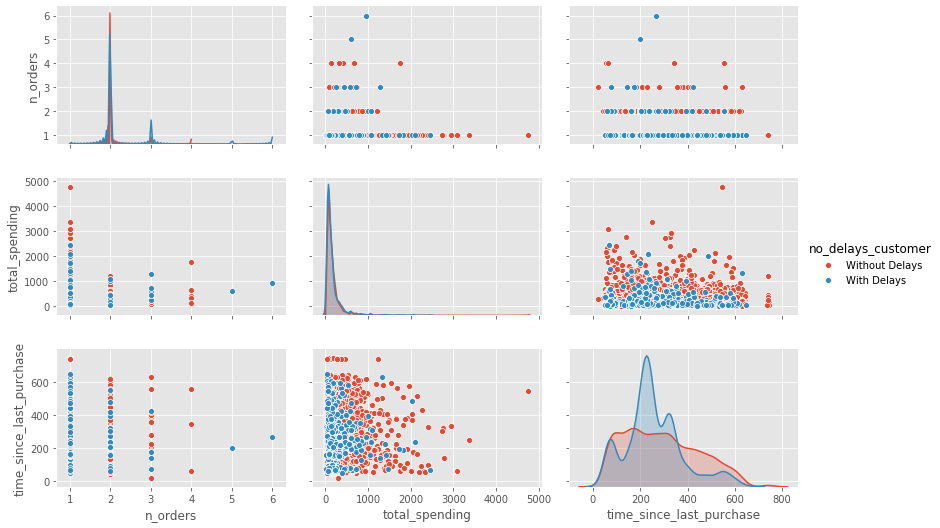

In [84]:
sns.pairplot(reduced_customers_df.sample(10000), hue='no_delays_customer', aspect=1.5)
plt.show()

### RFM

El RFM se basa en realizar particiones por percentiles (quintiles habitualmente) de variables de recencia, frecuencia e importe monentario para segmentar manualmente los clientes. 

In [85]:
reduced_customers_df['recency'] = pd.qcut(reduced_customers_df['time_since_last_purchase'], q=5, labels=range(5))
reduced_customers_df['monetary_value'] = pd.qcut(reduced_customers_df['total_spending'], q=5, labels=range(5))
reduced_customers_df['frequency'] = (reduced_customers_df['n_orders'] > 1).astype(int)

In [86]:
reduced_customers_df.head(2).T

customer_unique_id,0000366f3b9a7992bf8c76cfdf3221e2,0000b849f77a49e4a4ce2b2a4ca5be3f
n_orders,1,1
total_spending,141.9,27.19
time_since_last_purchase,160,163
no_delays_customer,Without Delays,Without Delays
recency,1,1
monetary_value,3,0
frequency,0,0


In [87]:
reduced_customers_df.pivot_table(index='recency', values=['time_since_last_purchase'], aggfunc=[len, np.mean])

,len,mean
,time_since_last_purchase,time_since_last_purchase
recency,,
0,19324,94.166839
1,19299,185.444842
2,19043,270.176338
3,19300,366.464093
4,19129,524.501124


In [88]:
reduced_customers_df.pivot_table(index='monetary_value', values=['total_spending'], aggfunc=[len, np.mean])

,len,mean
,total_spending,total_spending
monetary_value,,
0,19221.0,39.742998
1,19219.0,70.697066
2,19222.0,108.824944
3,19214.0,165.842255
4,19219.0,447.885889


In [89]:
reduced_customers_df.pivot_table(index='frequency', values=['n_orders'], aggfunc=[len, np.mean])

,len,mean
,n_orders,n_orders
frequency,,
0,93098,1.000000
1,2997,2.116116


In [90]:
rm_df = pd.crosstab(reduced_customers_df['recency'], reduced_customers_df['monetary_value'])

In [91]:
rm_df

monetary_value,0,1,2,3,4
recency,,,,,
0,3842,3662,3883,3999,3938
1,3748,3653,3924,4061,3913
2,3951,3716,3789,3945,3642
3,3697,4147,3824,3724,3908
4,3983,4041,3802,3485,3818


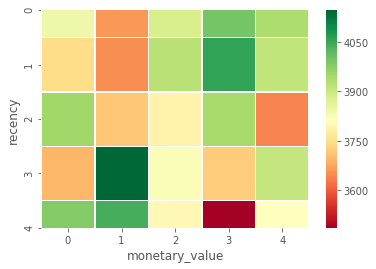

In [92]:
sns.heatmap(rm_df, cmap='RdYlGn', linewidths=0.5)

In [93]:
reduced_customers_df.groupby(['recency', 'frequency', 'monetary_value']).agg('count')

n_orders  total_spending  \
recency frequency monetary_value                             
0       0         0                   3835            3835   
                  1                   3629            3629   
                  2                   3798            3798   
                  3                   3841            3841   
                  4                   3529            3529   
        1         0                      7               7   
                  1                     33              33   
                  2                     85              85   
                  3                    158             158   
                  4                    409             409   
1       0         0                   3738            3738   
                  1                   3622            3622   
                  2                   3848            3848   
                  3                   3902            3902   
                  4                   3567            3567   
        1         0                     10              10   
                  1                     31              31   
                  2                     76              76   
                  3                    159             159   
                  4                    346             346   
2       0         0                   3949            3949   
                  1                   3689            3689   
                  2                   3706            3706   
                  3                   3784            3784   
                  4                   3286            3286   
        1         0                      2               2   
                  1                     27              27   
                  2                     83              83   
                  3                    161             161   
                  4                    356             356   
3       0         0                   3692            3692   
                  1                   4110            4110   
                  2                   3725            3725   
                  3                   3575            3575   
                  4                   3607            3607   
        1         0                      5               5   
                  1                     37              37   
                  2                     99              99   
                  3                    149             149   
                  4                    301             301   
4       0         0                   3975            3975   
                  1                   4003            4003   
                  2                   3729            3729   
                  3                   3366            3366   
                  4                   3593            3593   
        1         0                      8               8   
                  1                     38              38   
                  2                     73              73   
                  3                    119             119   
                  4                    225             225   

                                  time_since_last_purchase  no_delays_customer  
recency frequency monetary_value                                                
0       0         0                                   3835                3835  
                  1                                   3629                3629  
                  2                                   3798                3798  
                  3                                   3841                3841  
                  4                                   3529                3529  
        1         0                                      7                   7  
                  1                                     33                  33  
                  2                                     85                  85  

### KMeans

Como alternativa, el KMeans se construye con técnicas de Machine Learning (aprendizaje no supervisado) y permite la segmentación automática de los datos. 

Es importante **estandarizar el rango de las variables** para realizar un KMeans, y también guiar al algoritmo en la selección de variables.

Para realizar el modelo utilizaremos el método Pipeline.

In [94]:
pipe = Pipeline(
        steps=[
            ('StandardScaler', StandardScaler()),
            ('KMeans', KMeans(n_clusters=4))
        ]
)

In [95]:
pipe

Pipeline(memory=None,
         steps=[('StandardScaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('KMeans',
                 KMeans(algorithm='auto', copy_x=True, init='k-means++',
                        max_iter=300, n_clusters=4, n_init=10, n_jobs=None,
                        precompute_distances='auto', random_state=None,
                        tol=0.0001, verbose=0))],
         verbose=False)

In [96]:
pipe.fit(reduced_customers_df[['n_orders', 'total_spending', 'time_since_last_purchase']])

Pipeline(memory=None,
         steps=[('StandardScaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('KMeans',
                 KMeans(algorithm='auto', copy_x=True, init='k-means++',
                        max_iter=300, n_clusters=4, n_init=10, n_jobs=None,
                        precompute_distances='auto', random_state=None,
                        tol=0.0001, verbose=0))],
         verbose=False)

In [97]:
pipe

Pipeline(memory=None,
         steps=[('StandardScaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('KMeans',
                 KMeans(algorithm='auto', copy_x=True, init='k-means++',
                        max_iter=300, n_clusters=4, n_init=10, n_jobs=None,
                        precompute_distances='auto', random_state=None,
                        tol=0.0001, verbose=0))],
         verbose=False)

In [98]:
reduced_customers_df['Cluster'] = pipe.predict(reduced_customers_df[['n_orders', 'total_spending', 'time_since_last_purchase']])

In [99]:
reduced_customers_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Index: 96095 entries, 0000366f3b9a7992bf8c76cfdf3221e2 to ffffd2657e2aad2907e67c3e9daecbeb
Data columns (total 8 columns):
n_orders                    96095 non-null int64
total_spending              96095 non-null float64
time_since_last_purchase    96095 non-null int64
no_delays_customer          96095 non-null object
recency                     96095 non-null category
monetary_value              96095 non-null category
frequency                   96095 non-null int64
Cluster                     96095 non-null int32
dtypes: category(2), float64(1), int32(1), int64(3), object(1)
memory usage: 7.4+ MB


In [100]:
reduced_customers_df.head(2).T

customer_unique_id,0000366f3b9a7992bf8c76cfdf3221e2,0000b849f77a49e4a4ce2b2a4ca5be3f
n_orders,1,1
total_spending,141.9,27.19
time_since_last_purchase,160,163
no_delays_customer,Without Delays,Without Delays
recency,1,1
monetary_value,3,0
frequency,0,0
Cluster,0,0


In [101]:
reduced_customers_df.groupby('Cluster').agg({
    'n_orders': 'mean',
    'total_spending': 'mean',
    'time_since_last_purchase': 'mean'
})

,n_orders,total_spending,time_since_last_purchase
Cluster,,,
0,1.000000,135.164795,177.361668
1,1.000000,134.926653,437.803699
2,1.015690,1196.225244,288.490091
3,2.116475,290.305945,268.306212


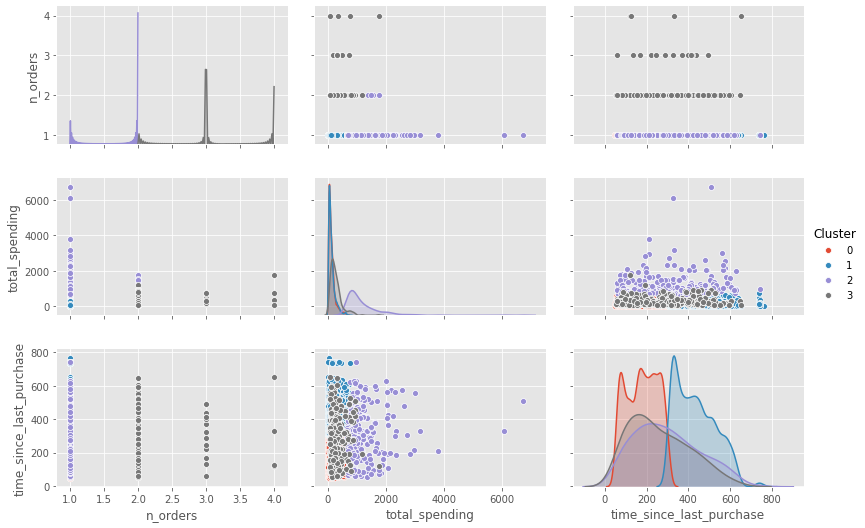

In [102]:
sns.pairplot(reduced_customers_df.sample(10000), vars=['n_orders', 'total_spending', 'time_since_last_purchase'], hue='Cluster', aspect=1.5)
plt.show()

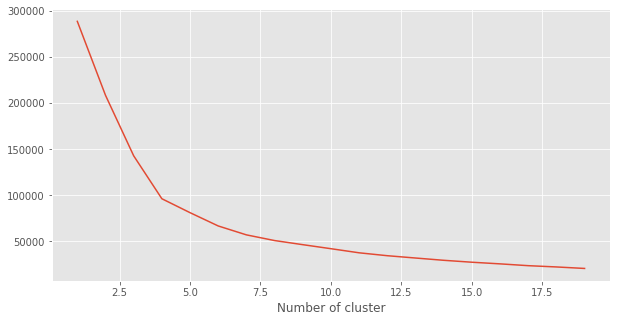

In [103]:
sse = {}

for k in range(1, 20):
    pipe = Pipeline(
            steps=[
                ('StandardScaler', StandardScaler()),
                ('KMeans', KMeans(n_clusters=k))
            ]
        ).fit(reduced_customers_df[['n_orders', 'total_spending', 'time_since_last_purchase']])
    reduced_customers_df['Cluster'] = pipe['KMeans'].labels_
    sse[k] = pipe['KMeans'].inertia_
    
plt.figure(figsize=(10, 5))
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel('Number of cluster')
plt.show()

In [104]:
pipe = Pipeline(
        steps=[
            ('StandardScaler', StandardScaler()),
            ('KMeans', KMeans(n_clusters=8))
        ]
).fit(reduced_customers_df[['n_orders', 'total_spending', 'time_since_last_purchase']])

In [105]:
reduced_customers_df['Cluster'] = pipe['KMeans'].labels_

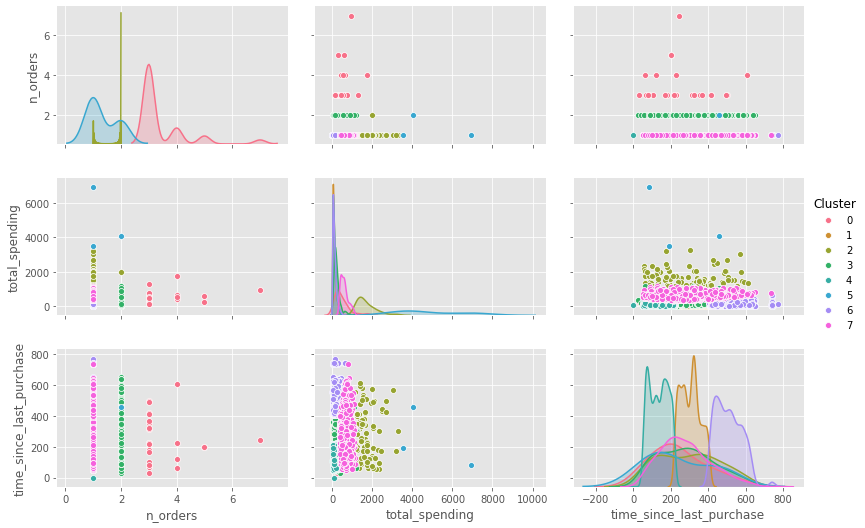

In [106]:
sns.pairplot(reduced_customers_df.sample(10000), vars=['n_orders', 'total_spending', 'time_since_last_purchase'], hue='Cluster', aspect=1.5)
plt.show()

In [107]:
reduced_customers_df.groupby('Cluster').agg({
    'n_orders': 'mean',
    'total_spending': 'mean',
    'time_since_last_purchase': 'mean'
})

,n_orders,total_spending,time_since_last_purchase
Cluster,,,
0,3.380000,481.833560,246.956000
1,1.000000,116.589944,304.922078
2,1.035842,1680.355735,295.608124
3,2.000000,272.650376,270.274336
4,1.000000,122.731673,135.682039
5,1.258065,5101.725161,321.903226
6,1.000000,125.959277,509.427252
7,1.000000,622.225153,271.915328


Únicamente como check, vamos a ver qué ocurre si hacemos la segmentación sin estandarizar

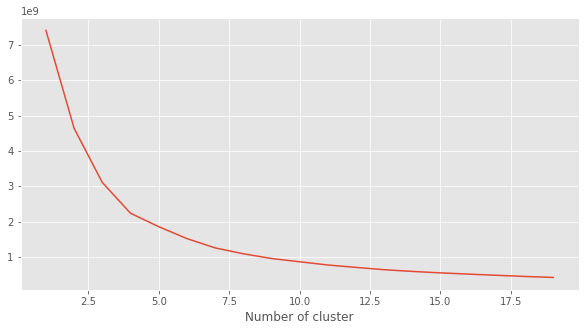

In [108]:
sse = {}

for k in range(1, 20):
    pipe = Pipeline(
            steps=[
#                ('StandardScaler', StandardScaler()),
                ('KMeans', KMeans(n_clusters=k))
            ]
        ).fit(reduced_customers_df[['n_orders', 'total_spending', 'time_since_last_purchase']])
    reduced_customers_df['Cluster'] = pipe['KMeans'].labels_
    sse[k] = pipe['KMeans'].inertia_
    
plt.figure(figsize=(10, 5))
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel('Number of cluster')
plt.show()

In [109]:
pipe = Pipeline(
        steps=[
       #     ('StandardScaler', StandardScaler()),
            ('KMeans', KMeans(n_clusters=8))
        ]
).fit(reduced_customers_df[['n_orders', 'total_spending', 'time_since_last_purchase']])

In [110]:
reduced_customers_df['Cluster'] = pipe['KMeans'].labels_

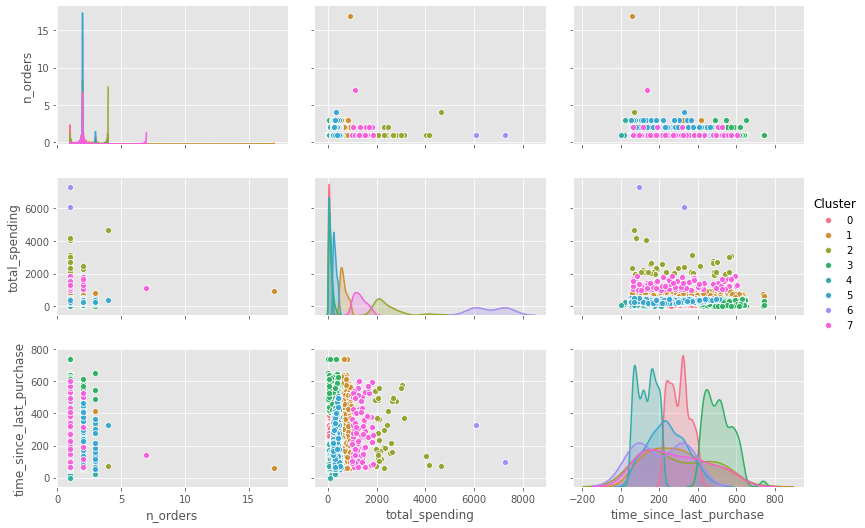

In [111]:
sns.pairplot(reduced_customers_df.sample(10000), vars=['n_orders', 'total_spending', 'time_since_last_purchase'], hue='Cluster', aspect=1.5)
plt.show()

In [112]:
reduced_customers_df.groupby('Cluster').agg({
    'n_orders': 'mean',
    'total_spending': 'mean',
    'time_since_last_purchase': 'mean'
})

,n_orders,total_spending,time_since_last_purchase
Cluster,,,
0,1.017780,95.144727,306.900366
1,1.126153,669.500408,300.404344
2,1.077220,2467.790463,278.532819
3,1.023752,121.233617,511.202133
4,1.021234,102.521489,133.852746
5,1.104217,311.867552,236.000656
6,1.375000,8090.416250,329.000000
7,1.123218,1299.146589,291.776986
